In [4]:
import numpy as np
import monai
import nibabel as nb
import matplotlib.pyplot as plt

In [47]:
nii_img_reader = monai.data.NibabelReader()
nii_img = nii_img_reader.read("./code/data/CT/study_0255.nii")
print(nii_img)

<class 'nibabel.nifti1.Nifti1Image'>
data shape (512, 512, 38)
affine: 
[[-9.22999978e-01  0.00000000e+00  0.00000000e+00  2.22194000e+02]
 [ 0.00000000e+00  9.22999978e-01  0.00000000e+00 -2.35786484e+02]
 [ 0.00000000e+00  0.00000000e+00  8.00000000e+00 -9.61700012e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00  1.00000000e+00]]
metadata:
<class 'nibabel.nifti1.Nifti1Header'> object, endian='<'
sizeof_hdr      : 348
data_type       : b''
db_name         : b''
extents         : 0
session_error   : 0
regular         : b'r'
dim_info        : 0
dim             : [  3 512 512  38   1   1   1   1]
intent_p1       : 0.0
intent_p2       : 0.0
intent_p3       : 0.0
intent_code     : none
datatype        : int16
bitpix          : 16
slice_start     : 0
pixdim          : [-1.     0.923  0.923  8.     0.     0.     0.     0.   ]
vox_offset      : 0.0
scl_slope       : nan
scl_inter       : nan
slice_end       : 0
slice_code      : unknown
xyzt_units      : 2
cal_max         : 0.0
cal_min

In [6]:
# alternative to above (using nibabel instead of monai)
nii_img_metadata = nb.load("./code/data/CT/study_0255.nii")
print(nii_img_metadata)

# affine: 
# [[-9.22999978e-01  0.00000000e+00  0.00000000e+00  2.22194000e+02]
#  [ 0.00000000e+00  9.22999978e-01  0.00000000e+00 -2.35786484e+02]
#  [ 0.00000000e+00  0.00000000e+00  8.00000000e+00 -9.61700012e+02] #8.0000 is causing the img to b shifted down by 8
#  [ 0.00000000e+00  0.00000000e+00  0.00000000e+00  1.00000000e+00]]
# 4x4 affine trans matrix for 3x3 img

<class 'nibabel.nifti1.Nifti1Image'>
data shape (512, 512, 38)
affine: 
[[-9.22999978e-01  0.00000000e+00  0.00000000e+00  2.22194000e+02]
 [ 0.00000000e+00  9.22999978e-01  0.00000000e+00 -2.35786484e+02]
 [ 0.00000000e+00  0.00000000e+00  8.00000000e+00 -9.61700012e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00  1.00000000e+00]]
metadata:
<class 'nibabel.nifti1.Nifti1Header'> object, endian='<'
sizeof_hdr      : 348
data_type       : b''
db_name         : b''
extents         : 0
session_error   : 0
regular         : b'r'
dim_info        : 0
dim             : [  3 512 512  38   1   1   1   1]
intent_p1       : 0.0
intent_p2       : 0.0
intent_p3       : 0.0
intent_code     : none
datatype        : int16
bitpix          : 16
slice_start     : 0
pixdim          : [-1.     0.923  0.923  8.     0.     0.     0.     0.   ]
vox_offset      : 0.0
scl_slope       : nan
scl_inter       : nan
slice_end       : 0
slice_code      : unknown
xyzt_units      : 2
cal_max         : 0.0
cal_min

(512, 512, 38)


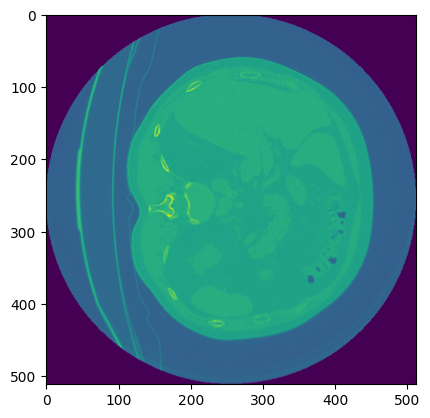

In [49]:
# 4. Visualize the slices from the NIFTI image.
# here, z is the 3rd dimension - always chk!!
print(nii_img_metadata.shape)

# also, double chk through imgs
nii_img = nii_img_metadata.get_fdata()
plt.imshow(nii_img[:,:,0]) #just get the 0th slice
plt.show()
# this img is showing a top-bottom (i.e. the z-axis) view...thus, it's correct

(512, 512, 38)


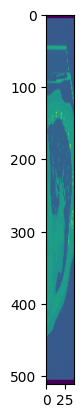

In [8]:
# here, x is the 1st dimension...
# always chk!!
print(nii_img_metadata.shape)

# also, double chk through imgs
nii_img = nii_img_metadata.get_fdata()

plt.imshow(nii_img[200,:,:]) #get the 200th slice on the x-axis
plt.show()

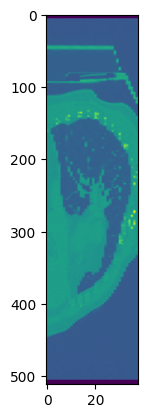

In [13]:
# need to set aspect ratio to widen view
plt.imshow(nii_img[200,:,:], aspect=.3) #get the 200th slice on the x-axis
plt.show()

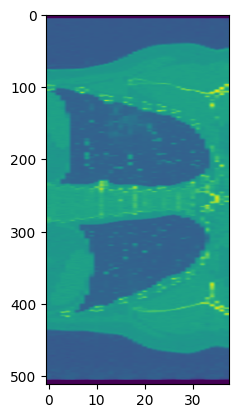

In [15]:
# here, y is the 2nd dimension...
# always chk!!
plt.imshow(nii_img[:,200,:], aspect=.15) #get the 200th slice on the x-axis
plt.show()

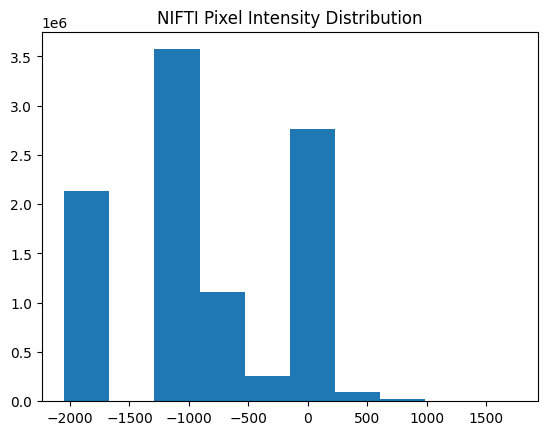

In [42]:
# 1.  Generate a pixel intensity histogram comparing a NIFTI image with a DICOM image (note: DICOM histogram is shown in lab_xray.ipynb).
nii_img_hist = nii_img.flatten()
plt.hist(nii_img_hist)
plt.title('NIFTI Pixel Intensity Distribution')
plt.show()

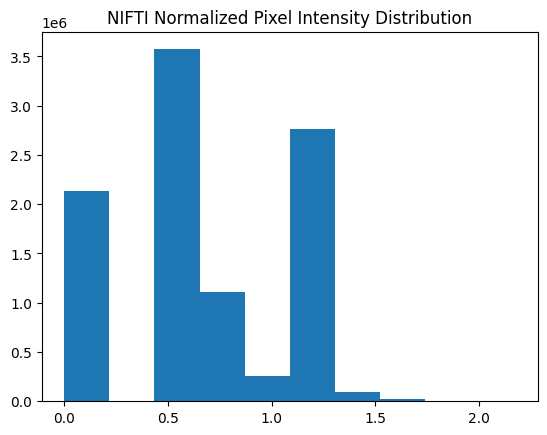

In [45]:
# 2.  Normalize the pixel values of the NIFTI and DICOM images to values between 0 and 1.
max_nii = np.max(nii_img)
min_nii = np.min(nii_img)
shift_nii = np.subtract(nii_img,min_nii)
norm_nii = np.divide(shift_nii, max_nii)

norm_nii_img_hist = norm_nii.flatten()
plt.hist(norm_nii_img_hist)
plt.title('NIFTI Normalized Pixel Intensity Distribution')
plt.show()

In [74]:
# EXTENDED ACTIVITY
# 2. From the NIFTI CT scan, generate image slices to visualize the muscle tissue in the scan.
from matplotlib import animation, rc
rc('animation', html='jshtml')

def create_animation(ims):
    fig = plt.figure(figsize=(6, 6))
    plt.axis('off')
    im = plt.imshow(ims[200,:,:], aspect=.3)#, cmap="gray")

    def animate_func(i):
        im.set_array(ims[i])
        return [im]

    return animation.FuncAnimation(fig, animate_func, frames = len(ims), interval = 1000//24)

create_animation(nii_img)


Animation size has reached 21001439 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [31]:
# EXTENDED ACTIVITY
# 3. Using the NIFTI scan and its segmentation mask, visualize the segmentation mask on top of
# the scan, then crop the image only leaving the masked regions.
nii_mask_meta = nb.load("./code/data/CT/study_0255.nii")
print(nii_mask_meta)

<class 'nibabel.nifti1.Nifti1Image'>
data shape (512, 512, 38)
affine: 
[[-9.22999978e-01 -0.00000000e+00  0.00000000e+00  2.22194000e+02]
 [ 0.00000000e+00  9.22999978e-01  0.00000000e+00 -2.35786484e+02]
 [ 0.00000000e+00  0.00000000e+00  8.00000000e+00 -9.61700012e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00  1.00000000e+00]]
metadata:
<class 'nibabel.nifti1.Nifti1Header'> object, endian='<'
sizeof_hdr      : 348
data_type       : b''
db_name         : b''
extents         : 0
session_error   : 0
regular         : b'r'
dim_info        : 0
dim             : [  3 512 512  38   1   1   1   1]
intent_p1       : 0.0
intent_p2       : 0.0
intent_p3       : 0.0
intent_code     : none
datatype        : int16
bitpix          : 16
slice_start     : 0
pixdim          : [-1.     0.923  0.923  8.     0.     0.     0.     0.   ]
vox_offset      : 0.0
scl_slope       : nan
scl_inter       : nan
slice_end       : 0
slice_code      : unknown
xyzt_units      : 10
cal_max         : 0.0
cal_mi

(512, 512, 38)


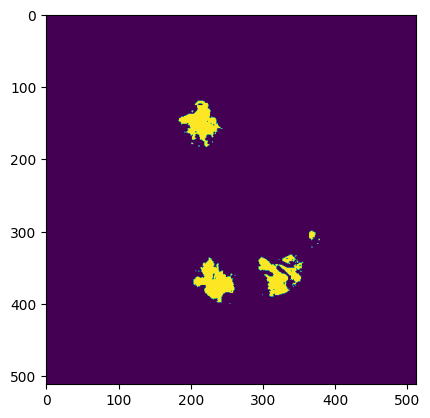

In [32]:
print(nii_mask_meta.shape)

nii_mask = nii_mask_meta.get_fdata()
plt.imshow(nii_mask[:,:,17])
plt.show()

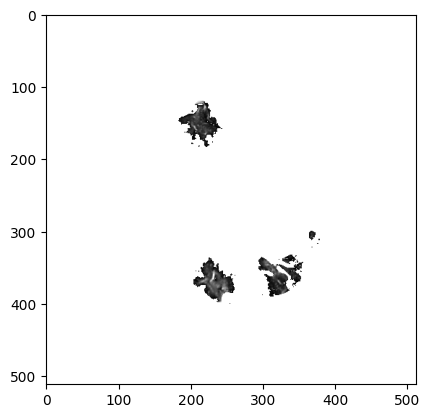

In [34]:
mask_on_img = nii_mask*nii_img
plt.imshow(mask_on_img[:,:,17], cmap = 'gray')
plt.show()

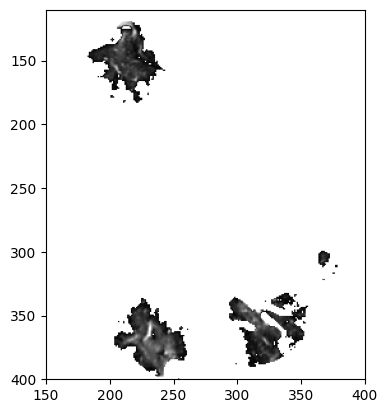

In [37]:
plt.imshow(mask_on_img[:,:,17], cmap = 'gray')
plt.xlim(150,400)
plt.ylim(400,110)
plt.show()

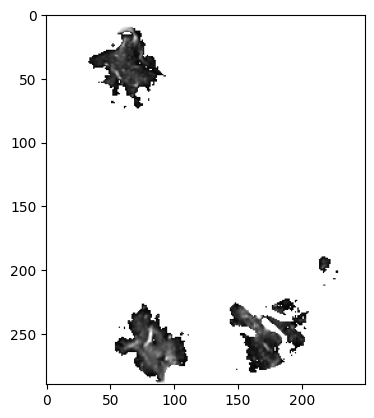

In [41]:
cropped_mask_on_img_slice = mask_on_img[110:400, 150:400, 17]

plt.imshow(cropped_mask_on_img_slice, cmap = 'gray')
plt.show()